# Mapping flowering areas workflow

**Summary**

A single pixel may contain several individual plants of different species, flowers, soil, and shadows with highly variable fractional coverage of the canopy area. This notebook comprises a two-step framework for mapping and tracking flowering dynamics from hyperspectral datasets:

1. Spectral mixture residual analysis
2. Unsupervised clustering based on the Gaussian mixture model (GMM)

We implemented the workflow on an open cloud computing environment (e.g., Amazon Web Service -AWS) that couples various Python libraries for imagery storage (e.g., Zarr), access (e.g., Intake), and managing multi-dimension arrays (e.g., Xarray), as described in (_Lang et al., 2023_). In addition, to perform the data analysis, we adapted the publicly available code posted by _Sousa et al., 2022_ to retrieve the mixture residual and the Gaussian Mixture module from the Scikit-learn library (_Pedregosa et al., 2011_) integrated with some visualization tools (e.g., hvPlot, Bokeh, matplotlib).


**References**

_Lang, E., Angel, Y., & Shiklomanov, A. N. (2023). SHIFT SMCE User Guide (v2.0.2). Zenodo. https://doi.org/10.5281/zenodo.7864544_

_Sousa, D., Brodrick, P., Cawse-Nicholson, K., Fisher, J. B., Pavlick, R., Small, C., & Thompson, D. R. (2022). The Spectral Mixture Residual: A Source of Low-Variance Information to Enhance the Explainability and Accuracy of Surface Biology and Geology Retrievals. Journal of Geophysical Research: Biogeosciences, 127(2), e2021JG006672. https://doi.org/10.1029/2021JG006672_

_Pedregosa, F., Varoquaux, G., Gramfort, A., Michel, V., Thirion, B., Grisel, O., Blondel, M., Prettenhofer, P., Weiss, R., Dubourg, V., Vanderplas, J., Passos, A., Cournapeau, D., Brucher, M., Perrot, M., & Duchesnay, É. (2011). Scikit-learn: Machine Learning in Python. Journal of Machine Learning Research, 12(85), 2825, https://doi.org/10.48550/arXiv.1201.0490_


## Setup

Import the required Python libraries.

Note: This code runs on the base conda environment. Double check your current environment before trying this notebook.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
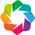

Loading BokehJS ...

In [1]:
%matplotlib inline

import os

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import pyplot as cm
import matplotlib.gridspec as gridspec
import matplotlib as mpl

from sklearn.decomposition import PCA
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler

from scipy import stats

# Use geopandas for vector data and xarray for raster data
import geopandas as gpd
import rioxarray as rxr
import xarray as xr
import rasterio
from rasterio.plot import show

import geoviews as gv
import geoviews.feature as gf
gv.extension('bokeh')
import datashader as dsh
from cartopy import crs

import holoviews as hv
from holoviews import opts
hv.extension('bokeh', 'matplotlib')
from holoviews.selection import link_selections
from holoviews.operation import gridmatrix
import holoviews.operation.datashader as hd

from bokeh.plotting import figure, show, output_notebook
output_notebook()

import time
import glob

#import earthpy as et

import seaborn as sns
# Prettier plotting with seaborn
sns.set(font_scale=1.3, style="white")
sns.set_theme()

from warnings import simplefilter
simplefilter(action="ignore", category=pd.errors.PerformanceWarning)

%matplotlib inline

## Opening AVIRIS-NG Data

For this study case, we will use the AVIRIS-NG dataset collected during the SBG-SHIFT campaign over The Jack and Laura Dangermond Preserve (The Nature Conservancy) in 2022 Spring. If you are on the provided SHIFT-SMCE cloud computing environment, you can follow the filepath below.

In [2]:
ds = rxr.open_rasterio("s3/dh-shift-curated/aviris/v1/gridded/20220308_box_rfl_phase")
ds

<xarray.DataArray (band: 425, y: 12023, x: 13739)>
[70203198725 values with dtype=float32]
Coordinates:
    fwhm         (band) float64 5.57 5.58 5.58 5.58 5.59 ... 6.02 6.02 6.02 6.03
    wavelength   (band) float64 377.2 382.2 387.2 ... 2.496e+03 2.501e+03
  * band         (band) int64 1 2 3 4 5 6 7 8 ... 419 420 421 422 423 424 425
  * x            (x) float64 7.177e+05 7.177e+05 ... 7.864e+05 7.864e+05
  * y            (y) float64 3.866e+06 3.866e+06 ... 3.806e+06 3.806e+06
    spatial_ref  int64 0
Attributes:
    wavelength:                377.1956495
    scale_factor:              1.0
    add_offset:                0.0
    long_name:                 ('377.1956495', '382.20564950000005', '387.215...
    bands:                     425
    byte_order:                0
    coordinate_system_string:  PROJCS["WGS_1984_UTM_Zone_10N",GEOGCS["GCS_WGS...
    data_type:                 4
    description:               flight_products/20220308/box_mosaics/box_rfl_p...
    file_type:                 ENVI Standard
    header_offset:             0
    interleave:                bil
    lines:                     12023
    map_info:                  UTM, 1, 1, 717720, 3865865, 5, 5, 10, North,WG...
    samples:                   13739

Subset the data to your area of interest (aoi) using the select method.

In [3]:
aoi = ds.sel(x=slice(730300,731000), y=slice(3819660,3819050))
aoi

<xarray.DataArray (band: 425, y: 122, x: 140)>
[7259000 values with dtype=float32]
Coordinates:
    fwhm         (band) float64 5.57 5.58 5.58 5.58 5.59 ... 6.02 6.02 6.02 6.03
    wavelength   (band) float64 377.2 382.2 387.2 ... 2.496e+03 2.501e+03
  * band         (band) int64 1 2 3 4 5 6 7 8 ... 419 420 421 422 423 424 425
  * x            (x) float64 7.303e+05 7.303e+05 7.303e+05 ... 7.31e+05 7.31e+05
  * y            (y) float64 3.82e+06 3.82e+06 3.82e+06 ... 3.819e+06 3.819e+06
    spatial_ref  int64 0
Attributes:
    wavelength:                377.1956495
    scale_factor:              1.0
    add_offset:                0.0
    long_name:                 ('377.1956495', '382.20564950000005', '387.215...
    bands:                     425
    byte_order:                0
    coordinate_system_string:  PROJCS["WGS_1984_UTM_Zone_10N",GEOGCS["GCS_WGS...
    data_type:                 4
    description:               flight_products/20220308/box_mosaics/box_rfl_p...
    file_type:                 ENVI Standard
    header_offset:             0
    interleave:                bil
    lines:                     12023
    map_info:                  UTM, 1, 1, 717720, 3865865, 5, 5, 10, North,WG...
    samples:                   13739

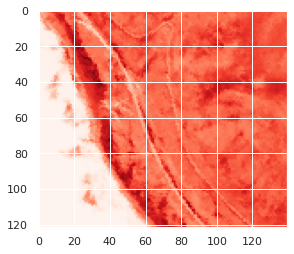

In [4]:
# Plot a single band view of your aoi to verify the data selection
plt.imshow(aoi[150], cmap='Reds')

## 1. Spectral Mixture Residual Analysis

We adapted the spectral mixture residual analysis from _Sousa et al., 2022_ to map flowers in spectroscopic imagery.

First, let's define the input Reflectance matrix **R(λ)**.

In [5]:
#Read aoi reflectance values and reshape to tall 2D matrix -> d(bands x pixels)

d = aoi.values
d = d.astype('float32')
d = np.reshape(d,[d.shape[0],d.shape[1]*d.shape[2]])

In [6]:
#copy d for performing a PCA-based unsupervised classification for comparison
d2 = d

Then, load the reference reflectance spectra or endmembers matrix **I(λ)** (bands x i). Following a convex-geometry based framework that defines the spectral feature space by a generalized three-endmember Soil, Vegetation, Dark (SVD) model, we include Flower spectra as fourth endmember (e.g. i = 4).

Field spectra data was used as input endmembers organized in a *.csv file. Original ASD spectra was resampled to match the AVIRIS-NG spectral resolution.

In [7]:
#Read .csv file with five columns (wavelength, endmember1, endmember2, endmember3, endmember4) 
endmember_file = 'efs/angellyb/Mapping_flowering_workflow/canopy_endmembers.csv'
#Multiply EMs by a scale factor? (e.g. reflectance from 0-1)
rescale = 1
G = pd.read_csv(endmember_file, sep = ",",header=None).to_numpy() * rescale

Water absoption features around 1320-1440 nm and 1770-1970 nm regions are removed. Typically this data is noisy due to the moisture present in the atmosphere; therefore, these spectral regions --also commonly known as 'bad bands'-- offer little information and can be excluded from calculations.

Load the 'bad bands' from a one-column .csv file that indicates the bad bands number marking with zero the 'good bands'. 

In [81]:
#Load badband list as an array (bands x 1)
badbands_file = 'efs/angellyb/Mapping_flowering_workflow/AVIRIS_badbands.csv'
bands = pd.read_csv(badbands_file, sep = ",",header=None).to_numpy()
bad = np.arange(0,bands.shape[0],1)
badbands = bad*bands
badbands = badbands[badbands > 0]
badbands

array([  1,   2,   3, ..., 422, 423, 424])

In [9]:
#Pull wavelengths out from reflectance datacube
waves = ds["wavelength"]
wavelength = waves.values
#wavelength.shape

In [10]:
#Apply bad bands list on reflectance matrix d and endmembers matrix G
d = d[badbands]
G = G[badbands]

Then, we deconvolve the reflectance of each pixel **R(λ)** into the proportion **Wi** (e.g., weight) of each individual endmember **Ii(λ)**, implementing a unit sum constraint.

In [11]:
#Set unit sum constraint weight
w = 1

In [12]:
#Append appropriate unit sum constraint rows
d_constraint = np.array(w*np.ones(d.shape[1]),ndmin=2)
G_constraint = np.array(w*np.ones(G.shape[1]),ndmin=2)

In [13]:
d = np.concatenate((d,d_constraint), axis=0)

In [14]:
G = np.concatenate((G,G_constraint), axis=0)

In [15]:
#Linear Unmixing using (GtG)-1 * Gtd least squares formulation to calculate the weights (W) matrix -> m
m = np.linalg.inv(G.transpose().dot(G)).dot(G.transpose().dot(d))   

In [16]:
#Reshape weights matrix m(endmembers x (rows x columns))
output = m.reshape([m.shape[0],aoi.shape[1],aoi.shape[2]])
output.shape

(4, 122, 140)

In [17]:
#Write weights matrix m to datacube file
output.astype('float32').tofile('20220308_box_rfl_Unmixed')

Then, we compute the modeled reflectance **R(λ)*** by calculating the weighted sum of the endmembers.

In [18]:
#Read again the endmembers file
G = pd.read_csv(endmember_file, sep = ",",header=None).to_numpy() * rescale
G = G.astype('float32')

In [19]:
#Estimate modeled reflectance by multiply the endmembers weight matrix m by the endmembers matrix G
modeled = m.transpose().dot(G.transpose()).transpose()

In [20]:
#Reshape the modeled reflectance matrix (bands x (rows x columns))
modeledOutput = modeled.reshape([modeled.shape[0],aoi.shape[1],aoi.shape[2]])
modeledOutput.shape

(425, 122, 140)

In [21]:
#Write modeled reflectance to datacube file
modeledOutput.astype('float32').tofile('20220308_box_rfl_Modeled')

Finally, we subtract the observed reflectance **R(λ)** from the modeled **R(λ)*** to obtain the mixture residual reflectance **(MRR)** 

In [22]:
#Remake d in case you want the 'bad bands' back
d = aoi.values
d = d.astype('float32')
d = np.reshape(d,[d.shape[0],d.shape[1]*d.shape[2]])

In [23]:
#Calculate MRR
mixtureResidual = d - modeled

In [24]:
#Reshape MRR matrix (bands x (rows x columns))
mixtureResidualOutput = mixtureResidual.reshape([modeled.shape[0],aoi.shape[1],aoi.shape[2]])
mixtureResidualOutput.shape

(425, 122, 140)

In [25]:
#Write MRR matrix to datacube file
mixtureResidualOutput.astype('float32').tofile('20220308_box_rfl_MixtureResidual')

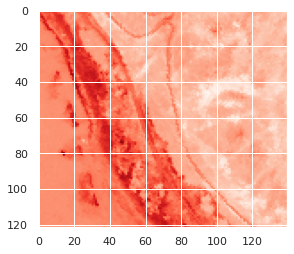

In [26]:
# Plot a single band view of MRR to verify the data selection
plt.imshow(mixtureResidualOutput[70], cmap='Reds')

## Plotting data and results ##
> **Note:** Different adjustment approaches (e.g., gamma, normalization, exponential, etc.) can be used to enhance image visualization. In this case, we are defining a histogram normalization function.

In [27]:
# Function to normalize the grid values
def normalize(array):
    """Normalizes numpy arrays into scale 0.0 - 1.0"""
    array_min, array_max = array.min(), array.max()
    return ((array - array_min)/(array_max - array_min))

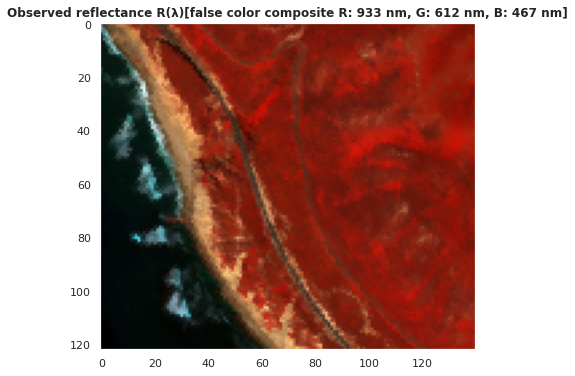

In [28]:
#False composition from Reflectance R(λ) R: 933 nm, G: 612 nm, B: 467 nm

# Read the grid values into numpy arrays (NIR:933nm, Red:612, Green:467)
nir = aoi[112]
red = aoi[48]
green = aoi[19]

# Normalize the values using the function that we defined earlier
nirn = normalize(nir)
redn = normalize(red)
greenn = normalize(green)

# Create the composite by stacking
nrg = np.dstack((nirn, redn, greenn))

# Let's see how our color composite looks like
plt.rcParams["figure.figsize"] = [8, 6]
plt.imshow(nrg)
plt.title("Observed reflectance R(λ)[false color composite R: 933 nm, G: 612 nm, B: 467 nm]", fontweight="bold")
plt.grid(None)

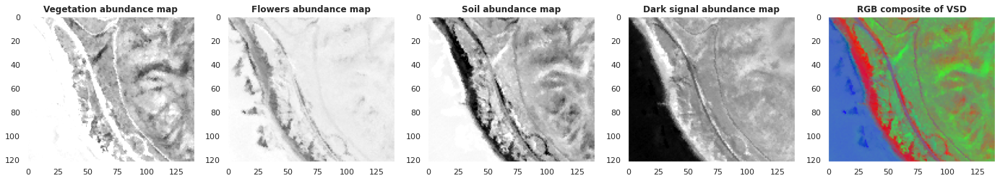

In [29]:
#False composition from unmixed endmembers
#0=vegetation, 1=flowers, 2=soil, 3=black (water, shadows)  

# Read the grid values into numpy arrays
nir = output[2]
red = output[0]
green = output[3]

# Normalize the values using the function that we defined earlier
nirn = normalize(nir)
redn = normalize(red)
greenn = normalize(green)

# Create the composite by stacking
nrg = np.dstack((nirn, redn, greenn))

plt.rcParams["figure.figsize"] = [24, 12]
plt.subplot(1,5,1)
plt.imshow(output[0], cmap='binary', vmin=0, vmax=1)
plt.title("Vegetation abundance map", fontweight="bold")
plt.grid(None)
plt.subplot(1,5,2)
plt.imshow(output[1], cmap='binary', vmin=0, vmax=1)
plt.title("Flowers abundance map", fontweight="bold")
plt.grid(None)
plt.subplot(1,5,3)
plt.imshow(output[2], cmap='binary', vmin=0, vmax=1)
plt.title("Soil abundance map", fontweight="bold")
plt.grid(None)
plt.subplot(1,5,4)
plt.imshow(output[3], cmap='binary', vmin=0, vmax=1)
plt.title("Dark signal abundance map", fontweight="bold")
plt.grid(None)
#plt.colorbar()
plt.subplot(1,5,5)
plt.imshow(nrg)
plt.title("RGB composite of VSD", fontweight="bold")
plt.grid(None)

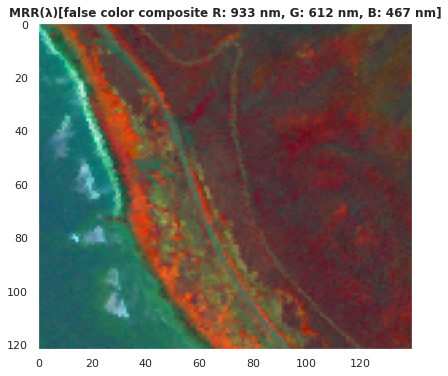

In [30]:
#False composition from MRR(λ) R: 933 nm, G: 612 nm, B: 467 nm

# Read the grid values into numpy arrays
nir = mixtureResidualOutput[326]
red = mixtureResidualOutput[65]
green = mixtureResidualOutput[30]

# Normalize the values using the function that we defined earlier
nirn = normalize(nir)
redn = normalize(red)
greenn = normalize(green)

# Create the composite by stacking
nrg = np.dstack((nirn, redn, greenn))

# Let's see how our color composite looks like
plt.rcParams["figure.figsize"] = [8, 6]
plt.imshow(nrg)
plt.title("MRR(λ)[false color composite R: 933 nm, G: 612 nm, B: 467 nm]", fontweight="bold")
plt.grid(None)

## 2. Unsupervised clustering based on the Gaussian mixture model (GMM) ##

### 2.1 PCA Analysis

The primary purpose of principal component analysis (PCA) is to reduce the spectral dimensionality (n = 1,2,3,…,λ) of the residual reflectance **MRR(λ)** dataset while retaining its maximum variation (i.e., >90%) through the largest eigenvalues and defining the new feature subspace (e.g., m ≤ n, with n PCs).

We want to compare the reflectance data with the resulting mixture residual reflectance (MRR), both projected in the low-order PC basis, to investigate how each of these feature spaces captures various spatial land cover patterns across different terrain (e.g., from the west coast to east hills).

#### 2.1.1 Reflectance PCA

First, we arrange the AOI reflectance dataframe

In [31]:
#Deleting bad bands from 2D array aoi image
aoi_ref = np.append(d2, bands, axis=1)
aoi_ref = np.delete(aoi_ref, np.where((aoi_ref[:, 17080] == 1))[0], axis=0) 
aoi_ref = np.delete(aoi_ref, 17080, axis=1)
aoi_ref = np.transpose(aoi_ref)
#aoi_ref.shape

#Deleting bad bands from wavelength array
aoi_bands = np.append(np.transpose(wavelength[None, :]), bands, axis=1)
aoi_bands = np.delete(aoi_bands, np.where((aoi_bands[:, 1] == 1))[0], axis=0) 
aoi_bands = np.delete(aoi_bands, 1, axis=1)
aoi_bands = np.transpose(aoi_bands)
#aoi_bands.shape

#Wavelengths are used to label the input variables (i.e. spectral bands)
aoi_features = aoi_bands.astype(int)
#aoi_features.shape

#Arrange AOI data as dataframe
aoi_data = pd.DataFrame(aoi_ref, columns=aoi_features.tolist())
aoi_data

,392,397,402,407,412,417,422,427,432,437,...,2400,2405,2410,2415,2420,2425,2430,2435,2440,2445
0,0.157699,0.167580,0.178497,0.166265,0.167918,0.165112,0.170905,0.175534,0.177955,0.182385,...,0.024948,0.026290,0.026615,0.026649,0.024913,0.024703,0.023340,0.024694,0.023029,0.023282
1,0.060143,0.054695,0.068021,0.063057,0.060057,0.061403,0.061008,0.065751,0.064561,0.066293,...,0.107193,0.112988,0.107950,0.110303,0.102603,0.100503,0.101262,0.101032,0.101208,0.109439
2,0.075203,0.073072,0.084010,0.080423,0.078144,0.078736,0.082728,0.085949,0.086619,0.086902,...,0.140733,0.140860,0.139231,0.137950,0.137214,0.134256,0.130897,0.135464,0.129853,0.134382
3,0.075136,0.077005,0.087979,0.082385,0.080685,0.081562,0.084732,0.089578,0.090468,0.092722,...,0.180836,0.181795,0.179745,0.179936,0.175855,0.170618,0.168176,0.169375,0.171528,0.168560
4,0.076174,0.076332,0.088583,0.083097,0.082808,0.085071,0.088619,0.092201,0.094319,0.095589,...,0.242886,0.245357,0.241444,0.244676,0.230985,0.230136,0.233296,0.224512,0.230250,0.233756
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17075,0.021100,0.021624,0.027231,0.025221,0.023501,0.024960,0.025468,0.026141,0.027946,0.026941,...,0.085551,0.085997,0.084765,0.086716,0.081118,0.080995,0.081287,0.079203,0.078723,0.078456
17076,0.024977,0.021475,0.028215,0.026800,0.025271,0.025815,0.026242,0.028671,0.028296,0.029905,...,0.107621,0.105234,0.106545,0.105885,0.100123,0.100881,0.096816,0.096407,0.097729,0.097899
17077,0.025735,0.021945,0.030086,0.028531,0.026458,0.026773,0.028452,0.029744,0.032139,0.030964,...,0.117600,0.121326,0.120503,0.116601,0.113393,0.111823,0.110401,0.103738,0.107462,0.107167
17078,0.023303,0.022598,0.031542,0.027465,0.026641,0.027001,0.027952,0.030515,0.031895,0.031540,...,0.124288,0.125205,0.124756,0.123123,0.119038,0.115404,0.116984,0.108799,0.114265,0.111978


The PCA linear dimensionality reduction is performed using Singular Value Decomposition of the data to project it to a lower dimensional space. Follow link for method details:
https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html

In [32]:
#Stimating Reflectance-PC with Sklearn
#Trial run with 4 components
pca = PCA(n_components=4).fit(aoi_data)

Let's retrieve the amount of variance explained by each PC and the cumulative variance reatined by the first four PCs.

In [33]:
# Get components relative variance (%)
(pca.explained_variance_ratio_)*100

array([87.77233791,  7.81956113,  3.77243556,  0.4760041 ])

In [34]:
# Cumulative proportion of variance (%)
np.cumsum(pca.explained_variance_ratio_)*100

array([87.77233791, 95.59189904, 99.3643346 , 99.8403387 ])

We can also retrieve the loading coefficients or weights, which indicate how each spectral band contributes to each PC. Large loadings indicate strong correlations (positively or negatively); hence they would be regarded as significant contributors to that principal component.

In [35]:
# component loadings or weights (correlation coefficient between original variables and the component) 
# component loadings represents the elements of the eigenvector
# the squared loadings within the PCs always sums to 1
loadings = pca.components_
num_pc = pca.n_features_
pc_list = ["PC"+str(i) for i in list(range(1, num_pc+1))]
loadings_df = pd.DataFrame.from_dict(dict(zip(pc_list, loadings)))
loadings_df['variable'] = aoi_data.columns.values
loadings_df = loadings_df.set_index('variable')
loadings_df

,PC1,PC2,PC3,PC4
variable,,,,
"(392,)",0.004541,-0.020413,0.062565,-0.050111
"(397,)",0.004751,-0.021504,0.063410,-0.051141
"(402,)",0.005071,-0.024757,0.070754,-0.057905
"(407,)",0.005244,-0.024819,0.069449,-0.056430
"(412,)",0.005398,-0.025072,0.068973,-0.055912
...,...,...,...,...
"(2425,)",0.042381,-0.056415,-0.015076,0.052725
"(2430,)",0.042010,-0.056730,-0.014493,0.051933
"(2435,)",0.041057,-0.054396,-0.013937,0.055685


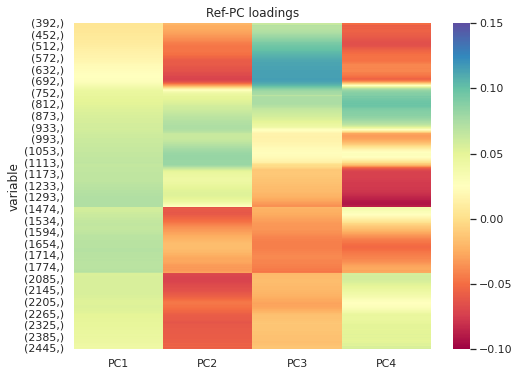

In [36]:
# positive and negative values in component loadings reflects the positive and negative 
# correlation of the variables(spectral bands) with the PCs.

# get correlation matrix plot for loadings
ax = sns.heatmap(loadings_df, annot=False, vmin=-0.1, vmax=0.15, cmap='Spectral')
plt.rcParams["figure.figsize"] = [8, 6]
plt.title('Ref-PC loadings')
plt.show()

Since the first three PCs comprise more than the 99% of the data variance, we can focus the analysis on them.

In [37]:
#Alternative method to stimate PCA with Sklearn standarizing the reflectance data

from sklearn.preprocessing import StandardScaler
pca2 = PCA(n_components=3)
Xs = StandardScaler().fit_transform(aoi_data)
Xpca = pca2.fit_transform(Xs)

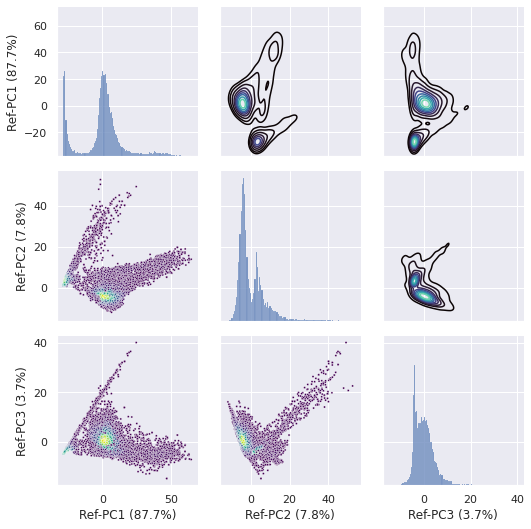

In [38]:
#Plotting first three PCA density correlograms

corre2 = pd.DataFrame(Xpca, columns=['Ref-PC1 (87.7%)', 'Ref-PC2 (7.8%)', 'Ref-PC3 (3.7%)'])
g = sns.PairGrid(corre2)
values = np.vstack([corre2["Ref-PC1 (87.7%)"], corre2["Ref-PC2 (7.8%)"], corre2["Ref-PC3 (3.7%)"]])
kernel = stats.gaussian_kde(values)(values)

g.map_lower(sns.scatterplot, c=kernel, cmap="viridis", size=0.005, marker=".")
g.map_upper(sns.kdeplot, cmap="mako",shade=False)
g.map_diag(sns.histplot)
plt.show()

In [39]:
#Plot PCs and scatterplots with interactive selection tools

xx, yy = np.meshgrid(aoi.x, aoi.y, indexing='ij')
pcsfig = Xpca.reshape(aoi.shape[1],aoi.shape[2],Xpca.shape[1])

pcsfig1 = xr.Dataset(
    data_vars=dict(
        variable=(["x","y","pc"],pcsfig)
    ),
    coords=dict(
        east=(["x"], aoi.y.values),
        north=(["y"], aoi.x.values),
        pc=(["pc"], [1,2,3])
    )
)

pc1 = pcsfig1['variable'][:,:,0]
pc2 = pcsfig1['variable'][:,:,1]
pc3 = pcsfig1['variable'][:,:,2]

pcsfig2 = hv.Dataset((pcsfig1.north, pcsfig1.east, pc1.values, pc2.values, pc3.values), ['East','North'],['Ref-PC1','Ref-PC2','Ref-PC3'])

output_notebook(hide_banner=True)

plots = [hv.Image(pcsfig2, vdims=vdim).opts(cmap='binary', clim=(-30,60), tools=['hover', 'lasso_select']) for vdim in pcsfig2.vdims]
plots.append(hv.Scatter(pcsfig2,'Ref-PC1','Ref-PC2')+hv.Scatter(pcsfig2,'Ref-PC1','Ref-PC3')+hv.Scatter(pcsfig2,'Ref-PC2','Ref-PC3'))

layout=hv.Layout(plots).cols(3)

link_selections(layout).opts(hv.opts.Image(tools=['hover','tap','lasso_select']), hv.opts.Scatter(tools=['hover','tap','lasso_select']))

#Use ONLY lasso tool to select data

:Layout
   .Image.I     :DynamicMap   []
      :Overlay
         .Image.I      :Image   [East,North]   (Ref-PC1)
         .Image.II     :Image   [East,North]   (Ref-PC1)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Image.II    :DynamicMap   []
      :Overlay
         .Image.I      :Image   [East,North]   (Ref-PC2)
         .Image.II     :Image   [East,North]   (Ref-PC2)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Image.III   :DynamicMap   []
      :Overlay
         .Image.I      :Image   [East,North]   (Ref-PC3)
         .Image.II     :Image   [East,North]   (Ref-PC3)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Scatter.I   :DynamicMap   []
      :Overlay
         .Scatter.I    :Scatter   [Ref-PC1]   (Ref-PC2)
         .Scatter.II   :Scatter   [Ref-PC1]   (Ref-PC2)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Scatter.II  :DynamicMap   []
      :Overlay
         .Scatter.I    :Scatter   [Ref-PC1]   (Ref-PC3)
         .Scatter.II   :Scatter   [Ref-PC1]   (Ref-PC3)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Scatter.III :DynamicMap   []
      :Overlay
         .Scatter.I    :Scatter   [Ref-PC2]   (Ref-PC3)
         .Scatter.II   :Scatter   [Ref-PC2]   (Ref-PC3)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]

In [40]:
XpcaT = np.transpose(Xpca)

#Reshape PCA to 3D dataframe
corre2_rgb = XpcaT.reshape(XpcaT.shape[0],mixtureResidualOutput.shape[1],mixtureResidualOutput.shape[2])
corre2_rgb.shape

r = corre2_rgb[2]
g = corre2_rgb[0]
b = corre2_rgb[1]

r = normalize(r)
g = normalize(g)
b = normalize(b)

hv.RGB(np.dstack([r,g,b])).opts(title="RGB-composite from Reflectance-PCs (R: Ref-PC1, G:Ref-PC2, B: Ref-PC3)")

:RGB   [x,y]   (R,G,B)

#### 2.1.2 MRR PCA

First, we arrange the MRR dataframe.

In [41]:
#Deleting bad bands from 2D array MRR image
aoi_res = np.append(mixtureResidual, bands, axis=1)
aoi_res = np.delete(aoi_res, np.where((aoi_res[:, 17080] == 1))[0], axis=0) 
aoi_res = np.delete(aoi_res, 17080, axis=1)
aoi_res = np.transpose(aoi_res)
#aoi_res.shape

#Arrange 2D-MRR as dataframe
aoi_resdata = pd.DataFrame(aoi_res, columns=aoi_features.tolist())
aoi_resdata

,392,397,402,407,412,417,422,427,432,437,...,2400,2405,2410,2415,2420,2425,2430,2435,2440,2445
0,0.152783,0.164017,0.175816,0.164094,0.166379,0.164399,0.170864,0.175701,0.177972,0.182343,...,-0.006174,-0.003730,-0.002957,-0.002126,-0.002131,-0.000713,0.000056,0.003853,0.003408,0.003257
1,0.039764,0.034436,0.047749,0.042615,0.039468,0.040755,0.040239,0.044670,0.043014,0.044344,...,-0.014080,-0.008030,-0.012753,-0.009676,-0.015376,-0.015869,-0.014371,-0.012946,-0.012050,-0.003854
2,0.049818,0.047986,0.059027,0.055320,0.052973,0.053622,0.057572,0.060456,0.060556,0.060351,...,-0.011695,-0.011380,-0.012806,-0.013066,-0.011078,-0.011962,-0.014111,-0.007345,-0.012146,-0.007665
3,0.043300,0.045367,0.056357,0.050548,0.048683,0.049527,0.052559,0.056950,0.057132,0.058771,...,-0.010361,-0.009364,-0.011264,-0.009865,-0.010673,-0.013488,-0.014658,-0.010993,-0.008014,-0.010981
4,0.035468,0.035969,0.048312,0.042606,0.042177,0.044477,0.047914,0.050945,0.052166,0.052658,...,-0.002441,-0.000011,-0.003855,0.000995,-0.008369,-0.006081,-0.001120,-0.006675,0.000059,0.003565
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17075,0.004823,0.005217,0.010556,0.008143,0.005970,0.007040,0.007168,0.007427,0.008784,0.007401,...,-0.004454,-0.002576,-0.002305,-0.000152,-0.004888,-0.003558,-0.003387,-0.003966,-0.002880,-0.003337
17076,0.005163,0.001469,0.007902,0.006051,0.004043,0.004170,0.004182,0.006146,0.005259,0.006427,...,-0.004495,-0.005726,-0.003117,-0.003440,-0.007977,-0.005633,-0.009744,-0.008585,-0.005847,-0.005808
17077,0.003532,-0.000461,0.007377,0.005389,0.002849,0.002763,0.004033,0.004840,0.006685,0.005030,...,-0.009956,-0.005331,-0.005078,-0.008517,-0.010189,-0.010079,-0.011423,-0.016463,-0.011482,-0.011861
17078,0.000322,-0.000578,0.008056,0.003531,0.002223,0.002170,0.002699,0.004758,0.005566,0.004714,...,-0.007527,-0.005621,-0.004907,-0.006064,-0.008563,-0.010435,-0.008767,-0.015233,-0.008415,-0.010801


PCA transformation of MRR data

In [42]:
#Stimating MRR-PCA with Sklearn
#Trial run with 4 components
pca_res = PCA(n_components=4).fit(aoi_resdata)

Let's retrieve the variance explained by each PC and the cumulative variance retained by the first four PCs.

In [43]:
# Get components relative variance (%)
(pca_res.explained_variance_ratio_)*100

array([59.41982383, 27.79010592,  7.63301388,  2.16128798])

In [44]:
# Cumulative proportion of variance (%)   
np.cumsum(pca_res.explained_variance_ratio_)*100

array([59.41982383, 87.20992975, 94.84294363, 97.00423161])

Text(0, 0.5, 'Cumulative explained variance')

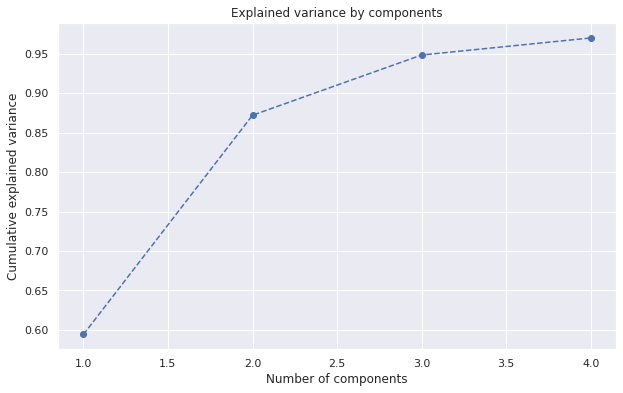

In [45]:
plt.figure(figsize = (10,6))
plt.plot(range(1,5), pca_res.explained_variance_ratio_.cumsum(), marker = 'o', linestyle = '--')
plt.title('Explained variance by components')
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')

Let's retrieve the loading coefficients or weights, which indicate how each spectral residual band contributes to each PC. Large loadings indicate strong correlations (positively or negatively); hence these would be regarded as significant contributors to that principal component.

In [46]:
# component loadings or weights (correlation coefficient between original variables and the component) 
# component loadings represents the elements of the eigenvector
# the squared loadings within the PCs always sums to 1
loadings_res = pca_res.components_
num_pc_res = pca_res.n_features_
pc_list_res = ["PC"+str(i) for i in list(range(1, num_pc_res+1))]
loadings_df_res = pd.DataFrame.from_dict(dict(zip(pc_list_res, loadings_res)))
loadings_df_res['variable'] = aoi_resdata.columns.values
loadings_df_res = loadings_df_res.set_index('variable')
loadings_df_res

,PC1,PC2,PC3,PC4
variable,,,,
"(392,)",0.047237,0.071847,0.122127,0.054036
"(397,)",0.047261,0.076049,0.125269,0.049596
"(402,)",0.050401,0.089013,0.140376,0.044285
"(407,)",0.049477,0.088953,0.137956,0.040938
"(412,)",0.049115,0.089990,0.137488,0.037761
...,...,...,...,...
"(2425,)",-0.006084,0.043500,-0.017465,0.034416
"(2430,)",-0.004181,0.046002,-0.015110,0.028853
"(2435,)",-0.001246,0.043842,-0.016574,0.046375


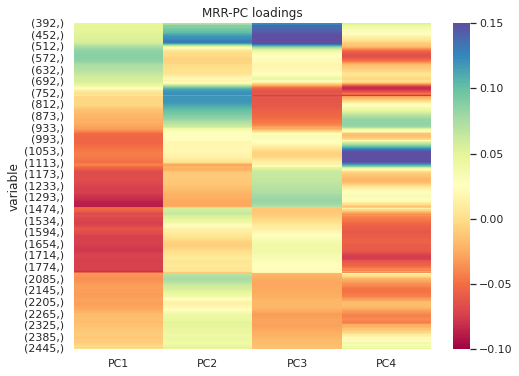

In [47]:
# positive and negative values in component loadings reflects the positive and negative 
# correlation of the variables with the PCs.

# get correlation matrix plot for loadings
ax_res = sns.heatmap(loadings_df_res, annot=False, vmin=-0.1, vmax=0.15, cmap='Spectral')
plt.rcParams["figure.figsize"] = [8, 6]
plt.title('MRR-PC loadings')
plt.show()

Since the first three PCs comprise ~95% of the data variance, we can focus the anazlysis on them.

In [48]:
#Alternative way to stimate PCA with Sklearn standarizing the MRR data

from sklearn.preprocessing import StandardScaler

pca2_res = PCA(n_components=3)
Xs_res = StandardScaler().fit_transform(aoi_resdata)
Xpca_res = pca2_res.fit_transform(Xs_res)

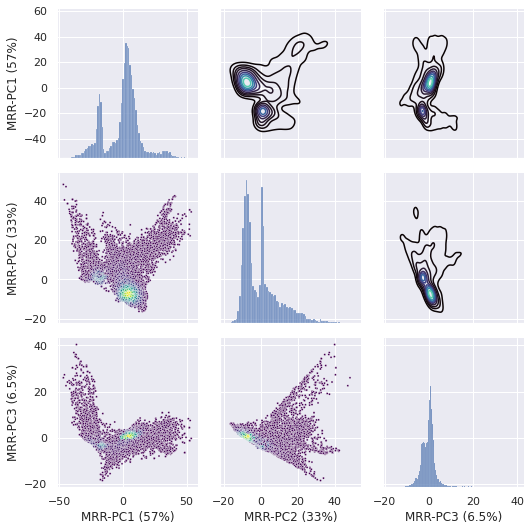

In [49]:
#Plotting first three PCA density correlograms

corre2_res = pd.DataFrame(Xpca_res, columns=['MRR-PC1 (57%)', 'MRR-PC2 (33%)', 'MRR-PC3 (6.5%)'])
g2 = sns.PairGrid(corre2_res)
values2 = np.vstack([corre2_res["MRR-PC1 (57%)"], corre2_res["MRR-PC2 (33%)"], corre2_res["MRR-PC3 (6.5%)"]])
kernel2 = stats.gaussian_kde(values2)(values2)

g2.map_lower(sns.scatterplot, c=kernel2, cmap="viridis", size=0.005, marker=".")
g2.map_upper(sns.kdeplot, cmap="mako",shade=False)
g2.map_diag(sns.histplot)
plt.show()

In [50]:
#Plot PCs and scatterplots with interactive selection tools 

pcs_res = Xpca_res.reshape(mixtureResidualOutput.shape[1],mixtureResidualOutput.shape[2],Xpca_res.shape[1])

pcs1_res = xr.Dataset(
    data_vars=dict(
        variable=(["x","y","pc"],pcs_res)
    ),
    coords=dict(
        east=(["x"], aoi.y.values),
        north=(["y"], aoi.x.values),
        pc=(["pc"], [1,2,3])
    )
)

pc1_res = pcs1_res['variable'][:,:,0]
pc2_res = pcs1_res['variable'][:,:,1]
pc3_res = pcs1_res['variable'][:,:,2]

pcs2_res = hv.Dataset((pcs1_res.north, pcs1_res.east, pc1_res.values, pc2_res.values, pc3_res.values), ['East','North'],['MRR-PC1','MRR-PC2','MRR-PC3'])

plots_res = [hv.Image(pcs2_res, vdims=vdim).opts(cmap='binary', clim=(-40,40), tools=['hover', 'lasso_select']) for vdim in pcs2_res.vdims]
plots_res.append(hv.Scatter(pcs2_res,'MRR-PC1','MRR-PC2')+hv.Scatter(pcs2_res,'MRR-PC1','MRR-PC3')+hv.Scatter(pcs2_res,'MRR-PC2','MRR-PC3'))

layout_res=hv.Layout(plots_res).cols(3)

link_selections(layout_res).opts(hv.opts.Image(tools=['hover','tap','lasso_select']),hv.opts.Scatter(tools=['hover','tap','lasso_select'], selection_color='#ff0000', nonselection_alpha=1, nonselection_color='#90FF90'))

#Use ONLY lasso tools to slect data

:Layout
   .Image.I     :DynamicMap   []
      :Overlay
         .Image.I      :Image   [East,North]   (MRR-PC1)
         .Image.II     :Image   [East,North]   (MRR-PC1)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Image.II    :DynamicMap   []
      :Overlay
         .Image.I      :Image   [East,North]   (MRR-PC2)
         .Image.II     :Image   [East,North]   (MRR-PC2)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Image.III   :DynamicMap   []
      :Overlay
         .Image.I      :Image   [East,North]   (MRR-PC3)
         .Image.II     :Image   [East,North]   (MRR-PC3)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Scatter.I   :DynamicMap   []
      :Overlay
         .Scatter.I    :Scatter   [MRR-PC1]   (MRR-PC2)
         .Scatter.II   :Scatter   [MRR-PC1]   (MRR-PC2)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Scatter.II  :DynamicMap   []
      :Overlay
         .Scatter.I    :Scatter   [MRR-PC1]   (MRR-PC3)
         .Scatter.II   :Scatter   [MRR-PC1]   (MRR-PC3)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Scatter.III :DynamicMap   []
      :Overlay
         .Scatter.I    :Scatter   [MRR-PC2]   (MRR-PC3)
         .Scatter.II   :Scatter   [MRR-PC2]   (MRR-PC3)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]

In [51]:
XpcaT_res = np.transpose(Xpca_res)

#Reshape PCA to 3D dataframe
corre2_res_rgb = XpcaT_res.reshape(XpcaT_res.shape[0],mixtureResidualOutput.shape[1],mixtureResidualOutput.shape[2])
corre2_res_rgb.shape

r = corre2_res_rgb[1]
g = corre2_res_rgb[0]
b = corre2_res_rgb[2]

r = normalize(r)
g = normalize(g)
b = normalize(b)

hv.RGB(np.dstack([r,g,b])).opts(title="RGB-composite from MRR-PCs (R: MRR-PC1, G: MRR-PC2, B: MRR-PC3)")

:RGB   [x,y]   (R,G,B)

### 2.2 Unsupervised clustering analysis

Considering the richest spectral separability reached by the MRR spectra domain and retained by the top three PCs, an unsupervised clustering analysis was performed on this data to assign each observation to a class - i.e., cluster or group - and estimate the probability of belonging to it. 

We are going to compare one of the most popular methods, K-means, with one probabilistic method, Gaussian mixture. We will see how both models perform and how different their results are.

#### 2.2.1 K-means

In [52]:
from sklearn.cluster import KMeans

K-means clusters data by splitting _k_ groups of equal variance around a centroid. 

To fit the K-means model, we have to estimate the optimal number of clusters _k_ by minimizing the distance between each data point and its centroid, also known as within-cluster sum-of-squares (WCSS) criterion.
We can visually identify the value of k where WCSS begins to decrease most rapidly by plotting WCSS for different values of _k_.

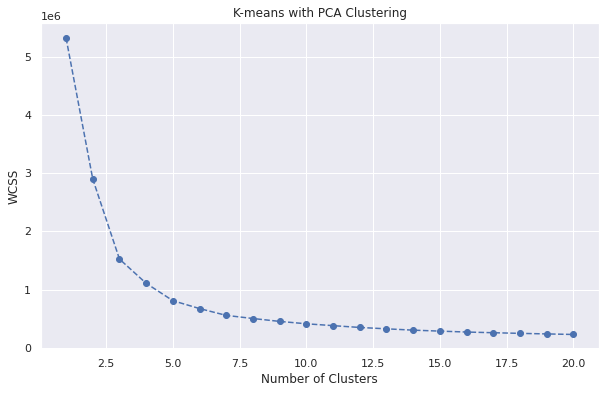

In [53]:
#PC scores
pca2_res.fit(Xs_res)
scores_pca_res = pca2_res.transform(Xs_res)

#Fit K-means using the transformed data from PCA. Testing up to 20 clusters
#Within Cluster Sum of Squares (WCSS)
wcss = []
for i in range(1,21):
    kmeans_pca_res = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans_pca_res.fit(scores_pca_res)
    wcss.append(kmeans_pca_res.inertia_)
    
#Based on the values of the WCSS and an approach known as the Elbow method, we make a decision about how many clusters we’d like to keep
#Plotting WCSS vs Number of Components
plt.figure(figsize=(10,6))
plt.plot(range(1,21), wcss, marker = 'o', linestyle = '--')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.title('K-means with PCA Clustering')
plt.show()

The location of _k=14_ indicates the part of the graph where "the elbow" is steeply declining, while the part after it – much smoother. Thus, we will fit a k-means model with that number of clusters.

In [54]:
#Fit K-means with k=14
kmeans_pca_res = KMeans(n_clusters = 14, init = 'k-means++', random_state = 42)
kmeans_pca_res.fit(scores_pca_res)

KMeans(n_clusters=14, random_state=42)

Let's plot the resulting clusters on the feature space based on MRR-PC1 and MRR-PC2.

In [55]:
#Create new dataframe with the original features and add the PCA scores and assigned clusters
df_segm_pca_kmeans = pd.concat([aoi_resdata.reset_index(drop=True), pd.DataFrame(scores_pca_res)], axis = 1)
df_segm_pca_kmeans.columns.values[-3:] = ['PC1','PC2','PC3']
#The last column we add contains the pca-kmeans clustering labels
df_segm_pca_kmeans['Segment_K-means_PCA'] = kmeans_pca_res.labels_
df_segm_pca_kmeans.head()

,"(392,)","(397,)","(402,)","(407,)","(412,)","(417,)","(422,)","(427,)","(432,)","(437,)",...,"(2420,)","(2425,)","(2430,)","(2435,)","(2440,)","(2445,)",PC1,PC2,PC3,Segment_K-means_PCA
0,0.152783,0.164017,0.175816,0.164094,0.166379,0.164399,0.170864,0.175701,0.177972,0.182343,...,-0.002131,-0.000713,0.000056,0.003853,0.003408,0.003257,-35.078632,19.682710,13.221045,9
1,0.039764,0.034436,0.047749,0.042615,0.039468,0.040755,0.040239,0.044670,0.043014,0.044344,...,-0.015376,-0.015869,-0.014371,-0.012946,-0.012050,-0.003854,-12.619255,3.223750,1.349352,7
2,0.049818,0.047986,0.059027,0.055320,0.052973,0.053622,0.057572,0.060456,0.060556,0.060351,...,-0.011078,-0.011962,-0.014111,-0.007345,-0.012146,-0.007665,-8.885728,6.846650,2.924737,3
3,0.043300,0.045367,0.056357,0.050548,0.048683,0.049527,0.052559,0.056950,0.057132,0.058771,...,-0.010673,-0.013488,-0.014658,-0.010993,-0.008014,-0.010981,-5.451655,10.010248,2.045649,3
4,0.035468,0.035969,0.048312,0.042606,0.042177,0.044477,0.047914,0.050945,0.052166,0.052658,...,-0.008369,-0.006081,-0.001120,-0.006675,0.000059,0.003565,5.789200,13.197927,0.828936,6


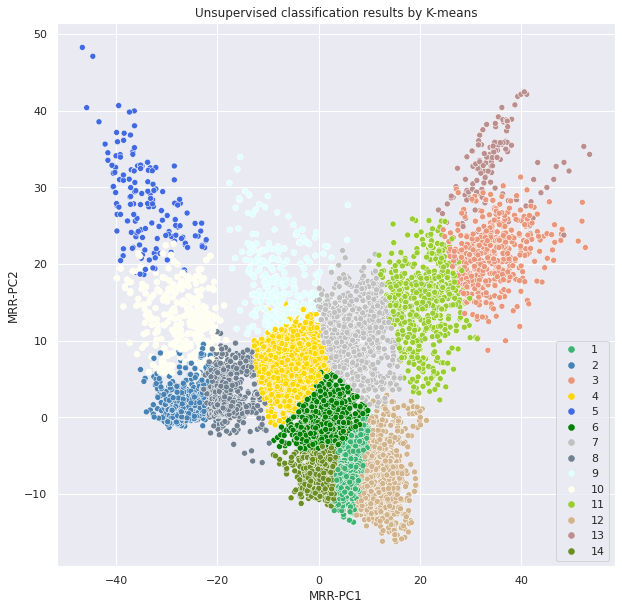

In [56]:
#Create a new column named Segment and map the N clusters directly inside it
df_segm_pca_kmeans['Segment'] = df_segm_pca_kmeans['Segment_K-means_PCA'].map({0:'1',1:'2',2:'3',3:'4',4:'5',5:'6',6:'7',7:'8',8:'9',9:'10',10:'11',11:'12',12:'13',13:'14'})

#Create a color map
cmap = (mpl.colors.ListedColormap(['mediumseagreen','steelblue', 'darksalmon', 'gold', 'royalblue' , 'green', 'silver', 'slategray', 'lightcyan', 'ivory','yellowgreen', 'tan', 'rosybrown', 'olivedrab']))
bounds = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]

#Plot data by PCA components. The Y axis is the first component, X axis is the second one
#optional using sns seaborn
#sns.scatterplot(x_axis, y_axis, hue = df_segm_pca_kmeans['Segment_K-means_PCA'], palette = "deep")

x_axis = df_segm_pca_kmeans['PC1']
y_axis = df_segm_pca_kmeans['PC2']

#plt.rcParams['axes.facecolor'] = 'white'

plt.figure(figsize = (10,10))
plt.xlabel("MRR-PC1")
#ax = plt.axes()
#ax.set_facecolor("white")
#plt.grid(color='gray')
plt.ylabel("MRR-PC2")
plt.title('Unsupervised classification results by K-means')
scatter = plt.scatter(x_axis, y_axis, c=df_segm_pca_kmeans['Segment_K-means_PCA'], cmap=cmap, linewidths= 0.5,edgecolors='white')
plt.legend(handles=scatter.legend_elements()[0], labels= bounds, loc ="lower right")
plt.show()

Let's also visualize the classification map.

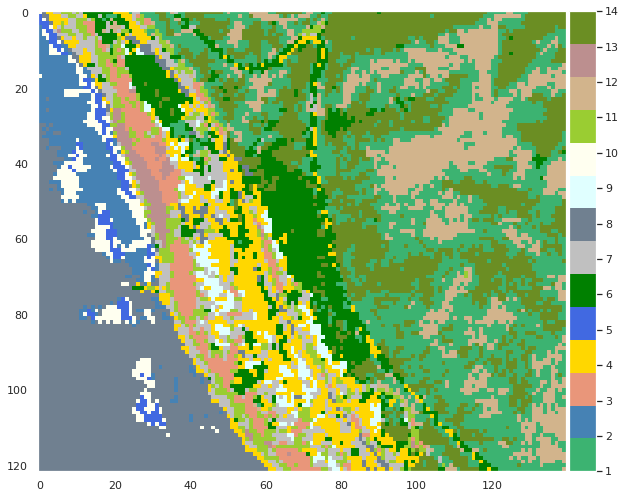

In [57]:
#Reshape Clusters to 2D dataframe
K_clusters = df_segm_pca_kmeans['Segment'].astype(str).astype(int)
K_clusters_map = K_clusters.values.reshape(mixtureResidualOutput.shape[1],mixtureResidualOutput.shape[2])


# Let's see how our clusters map looks like
plt.rcParams["figure.figsize"] = [10, 10]
#plt.imshow(K_clusters_map, cmap=cmap) #use interpolation = 'nearest' to blur the polygone's borders

from mpl_toolkits.axes_grid1 import make_axes_locatable

ax= plt.subplot()
ax.grid(False)
im = ax.imshow(K_clusters_map, cmap=cmap)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

plt.colorbar(im, cax=cax, ticks=np.linspace(1, 14, 14))
plt.show()

#### 2.2.2 Gaussian Mixture 

In [58]:
from sklearn.mixture import GaussianMixture

Gaussian Mixture is a probabilistic algorithm that assumes the probability distribution of the overall PC-MRR dataset comes frome a mixture of finite multivariate Gaussian distributions representing a certain number of _k_ subpopulations each, where every individual pixel from the PC-MRR dataset belongs to one of the _k_ classes.

An expectation-maximization (EM) process fits the Gaussian parameters (i.e., _θ = {means, covariances, mixing probabilities}_) by iteratively maximizing the probability that the model would reproduce the PC-MRR dataset.

We can initialize o generate the initial centers for the model components from the prior k-means initialization with the WCSS criterion.

In [59]:
#Initialize an instance of the GaussianMixture class with N clusters
n_clusters = 14
gmm_model = GaussianMixture(n_components=n_clusters)
gmm_model.fit(scores_pca_res)

GaussianMixture(n_components=14)

Let's estimate the labels for the PC-MRR dataset using the initialized model.

In [60]:
#Create new dataframe with the original features and add the PCA scores and assigned clusters
df_segm_pca_gmm = pd.concat([aoi_resdata.reset_index(drop=True), pd.DataFrame(scores_pca_res)], axis = 1)
df_segm_pca_gmm.columns.values[-3:] = ['PC1','PC2','PC3']
#The last column we add contains the pca-kmeans clustering labels
df_segm_pca_gmm['Segment_GMM_PCA'] = gmm_model.predict(scores_pca_res)
df_segm_pca_gmm.head()

,"(392,)","(397,)","(402,)","(407,)","(412,)","(417,)","(422,)","(427,)","(432,)","(437,)",...,"(2420,)","(2425,)","(2430,)","(2435,)","(2440,)","(2445,)",PC1,PC2,PC3,Segment_GMM_PCA
0,0.152783,0.164017,0.175816,0.164094,0.166379,0.164399,0.170864,0.175701,0.177972,0.182343,...,-0.002131,-0.000713,0.000056,0.003853,0.003408,0.003257,-35.078632,19.682710,13.221045,3
1,0.039764,0.034436,0.047749,0.042615,0.039468,0.040755,0.040239,0.044670,0.043014,0.044344,...,-0.015376,-0.015869,-0.014371,-0.012946,-0.012050,-0.003854,-12.619255,3.223750,1.349352,8
2,0.049818,0.047986,0.059027,0.055320,0.052973,0.053622,0.057572,0.060456,0.060556,0.060351,...,-0.011078,-0.011962,-0.014111,-0.007345,-0.012146,-0.007665,-8.885728,6.846650,2.924737,8
3,0.043300,0.045367,0.056357,0.050548,0.048683,0.049527,0.052559,0.056950,0.057132,0.058771,...,-0.010673,-0.013488,-0.014658,-0.010993,-0.008014,-0.010981,-5.451655,10.010248,2.045649,8
4,0.035468,0.035969,0.048312,0.042606,0.042177,0.044477,0.047914,0.050945,0.052166,0.052658,...,-0.008369,-0.006081,-0.001120,-0.006675,0.000059,0.003565,5.789200,13.197927,0.828936,8


We can also estimate the probabily of each cluster assignment, which can be considered as the Certainty of each data point to belong to the respective cluster.

In [61]:
#Relabeling clusters from 1 to 14 -> Segment
df_segm_pca_gmm['Segment'] = df_segm_pca_gmm['Segment_GMM_PCA'].map({0:'1',1:'2',2:'3',3:'4',4:'5',5:'6',6:'7',7:'8',8:'9',9:'10',10:'11',11:'12',12:'13',13:'14'})

#Probabilities estimation
probs = gmm_model.predict_proba(scores_pca_res)
size = 50 * probs.max(1) ** 2  # square emphasizes differences

#Creating new Certainty column
df_segm_pca_gmm['Certainty'] = size
df_segm_pca_gmm.head()

,"(392,)","(397,)","(402,)","(407,)","(412,)","(417,)","(422,)","(427,)","(432,)","(437,)",...,"(2430,)","(2435,)","(2440,)","(2445,)",PC1,PC2,PC3,Segment_GMM_PCA,Segment,Certainty
0,0.152783,0.164017,0.175816,0.164094,0.166379,0.164399,0.170864,0.175701,0.177972,0.182343,...,0.000056,0.003853,0.003408,0.003257,-35.078632,19.682710,13.221045,3,4,50.000000
1,0.039764,0.034436,0.047749,0.042615,0.039468,0.040755,0.040239,0.044670,0.043014,0.044344,...,-0.014371,-0.012946,-0.012050,-0.003854,-12.619255,3.223750,1.349352,8,9,40.407713
2,0.049818,0.047986,0.059027,0.055320,0.052973,0.053622,0.057572,0.060456,0.060556,0.060351,...,-0.014111,-0.007345,-0.012146,-0.007665,-8.885728,6.846650,2.924737,8,9,48.372142
3,0.043300,0.045367,0.056357,0.050548,0.048683,0.049527,0.052559,0.056950,0.057132,0.058771,...,-0.014658,-0.010993,-0.008014,-0.010981,-5.451655,10.010248,2.045649,8,9,48.204905
4,0.035468,0.035969,0.048312,0.042606,0.042177,0.044477,0.047914,0.050945,0.052166,0.052658,...,-0.001120,-0.006675,0.000059,0.003565,5.789200,13.197927,0.828936,8,9,41.860003


Let's plot the resulting clusters on the feature space based on MRR-PC1 and MRR-PC2.

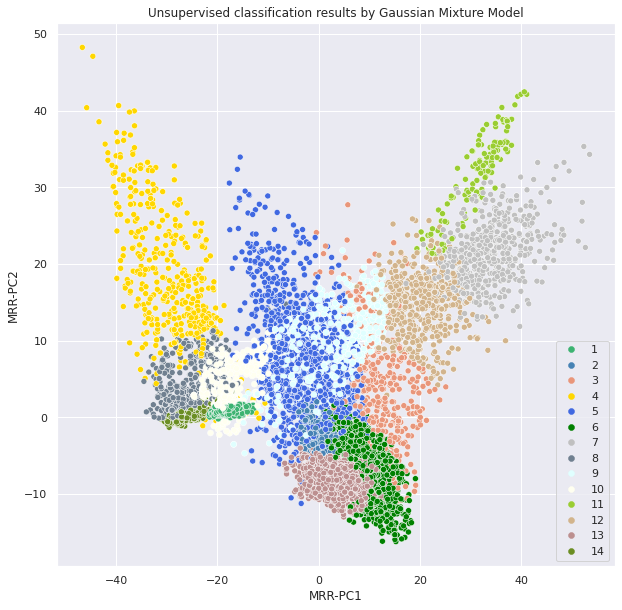

In [62]:
#Plot data by PCA components. The Y axis is the first component, X axis is the second one
#optional using sns seaborn
#sns.scatterplot(x_axis, y_axis, hue = df_segm_pca_kmeans['Segment_K-means_PCA'], palette = "deep")

x_axis = df_segm_pca_gmm['PC1']
y_axis = df_segm_pca_gmm['PC2']

#plt.rcParams['axes.facecolor'] = 'white'

plt.figure(figsize = (10,10))
plt.xlabel("MRR-PC1")
#ax = plt.axes()
#ax.set_facecolor("white")
#plt.grid(color='gray')
plt.ylabel("MRR-PC2")
plt.title('Unsupervised classification results by Gaussian Mixture Model')
scatter = plt.scatter(x_axis, y_axis, c=df_segm_pca_gmm['Segment_GMM_PCA'], cmap=cmap, linewidths= 0.5,edgecolors='white')
plt.legend(handles=scatter.legend_elements()[0], labels= bounds, loc ="lower right")
plt.show()

We can visualize step by step how the multivariate Gaussian distributions are fitted as _k_ increases.

The projection of the fitted Gaussian Probability Density Function (continuous black line) over the actual data distribution along both PCs (MRR-PC1 and MRR-PC2) shows how it is composed by the sum of the individual unmixed Gaussian PDFs per cluster (dashed colored lines).

In [63]:
# Fit models with 1-14 components
k_arr = np.arange(15) + 1
#k_arr = np.arange(1) + 14

models = [
    GaussianMixture(n_components=k).fit(scores_pca_res[:,1].reshape(-1, 1))
    for k in k_arr
]
models[0]

GaussianMixture()

In [64]:
# Plot function 
def plot_mixture(gmm, X, show_legend=True, ax=None):
    if ax is None:
        ax = plt.gca()
    
    # Compute PDF of whole mixture
    #x = np.linspace(-55, 55, (17080*3))
    #x = np.column_stack((np.linspace(-55, 55, 17080), np.linspace(-20, 50, 17080), np.linspace(-20, 45, 17080)))
    x = np.linspace(-55, 55, 17080)
    
    #logprob = gmm.score_samples(x.reshape(-1, 3))
    logprob = gmm.score_samples(x.reshape(-1, 1))
    #logprob = gmm.score_samples(x)
    #logprob = gmm.score_samples(X)
    pdf = np.exp(logprob)
    
    # Compute PDF for each component
    #responsibilities = gmm.predict_proba(x.reshape(-1, 3))
    responsibilities = gmm.predict_proba(x.reshape(-1, 1))
    #responsibilities = gmm.predict_proba(x)
    #responsibilities = gmm.predict_proba(X)
    pdf_individual = responsibilities * pdf[:, np.newaxis]
    
    # Plot data histogram
    ax.hist(X[:,0], 30, density=True, histtype='stepfilled', alpha=0.4, label='Data')
   
    # Plot PDF of whole model
    #ax.plot((x.reshape(-1, 3))[:,0], pdf, '-k', label='Mixture PDF')
    ax.plot((x.reshape(-1, 1))[:,0], pdf, '-k', label='Mixture PDF')
    #ax.plot(x[:,0], pdf, '-k', label='Mixture PDF')
    #ax.plot(X[:,0], pdf, '-k', label='Mixture PDF')
    
    # Plot PDF of each component
    #ax.plot(x[:,0], pdf_individual, '--', label='Component PDF')
    #ax.plot((x.reshape(-1, 3))[:,0], pdf_individual, '--', label='Component PDF')
    ax.plot((x.reshape(-1, 1))[:,0], pdf_individual, '--', label='Component PDF')
    #ax.plot(X[:,0], pdf_individual, '--', label='Component PDF')
    ax.set_xlabel('$x$')
    ax.set_ylabel('$p(x)$')
    if show_legend:
        ax.legend()

Text(0.5, 1.0, 'Gaussian Mixture probability distributions for MRR-PC1, fitted as K increases')

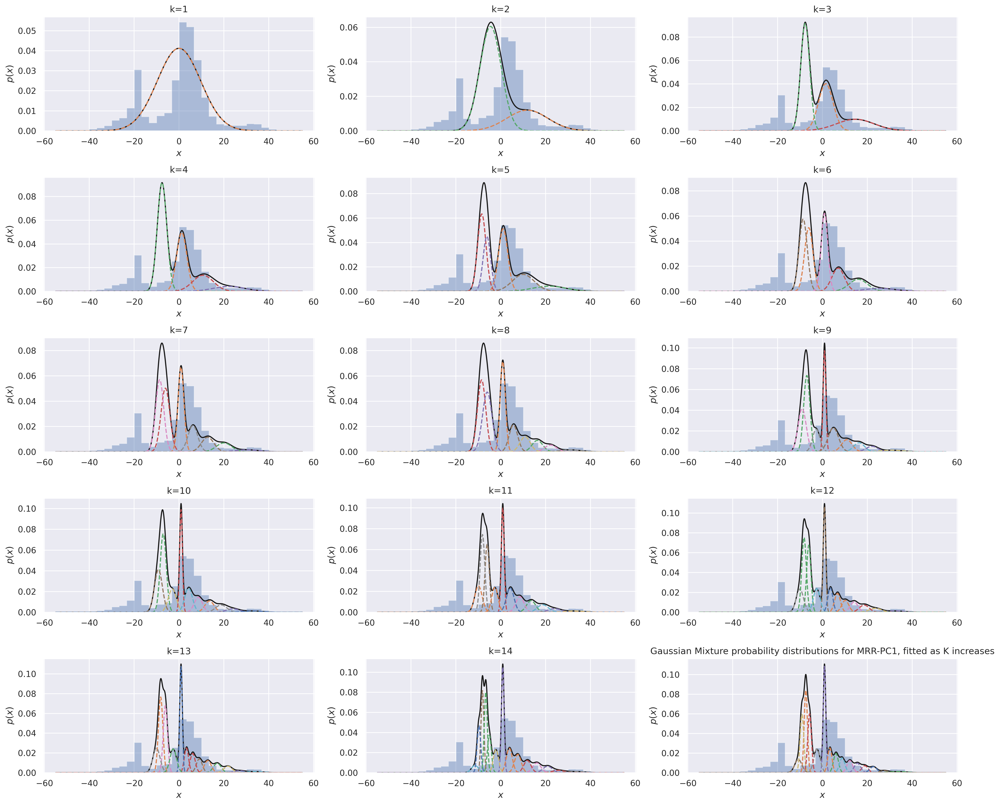

In [65]:
_, axes = plt.subplots(5, 3, figsize=np.array([6,5])*3, dpi=300)

for gmm, ax in zip(models, axes.ravel()):
#for gmm_model, ax in zip(models):
    plot_mixture(gmm, scores_pca_res[:,0].reshape(-1, 1), show_legend=False, ax=ax)
    ax.set_title(f'k={gmm.n_components}')
plt.tight_layout()
plt.title('Gaussian Mixture probability distributions for MRR-PC1, fitted as K increases') #MRR-PC1 -> scores_pca_res[:,0]

Text(0.5, 1.0, 'Gaussian Mixture probability distributions for MRR-PC2, fitted as K increases')

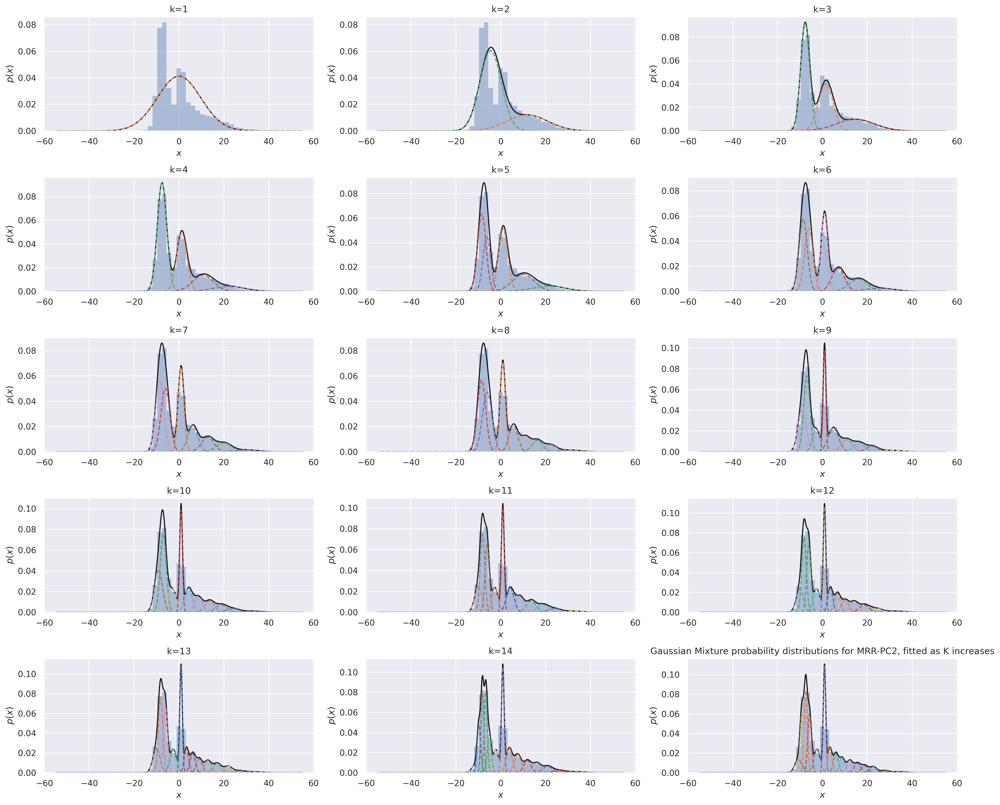

In [66]:
_, axes = plt.subplots(5, 3, figsize=np.array([6,5])*3, dpi=300)

for gmm, ax in zip(models, axes.ravel()):
#for gmm_model, ax in zip(models):
    plot_mixture(gmm, scores_pca_res[:,1].reshape(-1, 1), show_legend=False, ax=ax)
    ax.set_title(f'k={gmm.n_components}')
plt.tight_layout()
plt.title('Gaussian Mixture probability distributions for MRR-PC2, fitted as K increases') #MRR-PC2 -> scores_pca_res[:,1]

Text(0.5, 1.0, 'Gaussian Mixture probability distributions for MRR-PC3, fitted as K increases')

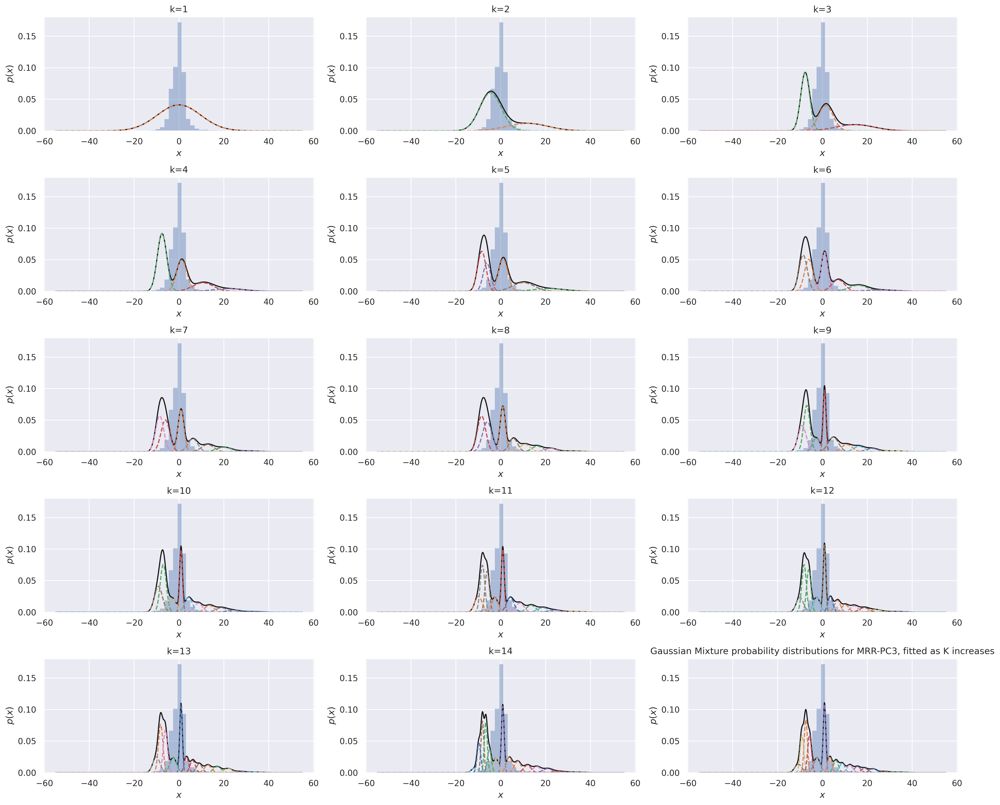

In [67]:
_, axes = plt.subplots(5, 3, figsize=np.array([6,5])*3, dpi=300)

for gmm, ax in zip(models, axes.ravel()):
#for gmm_model, ax in zip(models):
    plot_mixture(gmm, scores_pca_res[:,2].reshape(-1, 1), show_legend=False, ax=ax)
    ax.set_title(f'k={gmm.n_components}')
plt.tight_layout()
plt.title('Gaussian Mixture probability distributions for MRR-PC3, fitted as K increases') #MRR-PC3 -> scores_pca_res[:,2]

Let's also visualize the classification map.

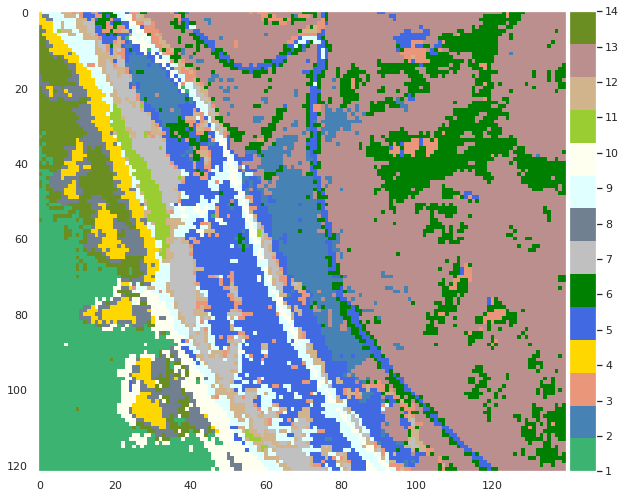

In [68]:
#Reshape Clusters to 2D dataframe
clusters = df_segm_pca_gmm['Segment'].astype(str).astype(int)
clusters_map = clusters.values.reshape(mixtureResidualOutput.shape[1],mixtureResidualOutput.shape[2])

# Let's see how our clusters map looks like
plt.rcParams["figure.figsize"] = [10, 10]

ax= plt.subplot()
ax.grid(False)
im = ax.imshow(clusters_map, cmap=cmap)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

plt.colorbar(im, cax=cax, ticks=np.linspace(1, 14, 14))
plt.show()

Let's also plot the Certainty map to assess their spatial distribution.

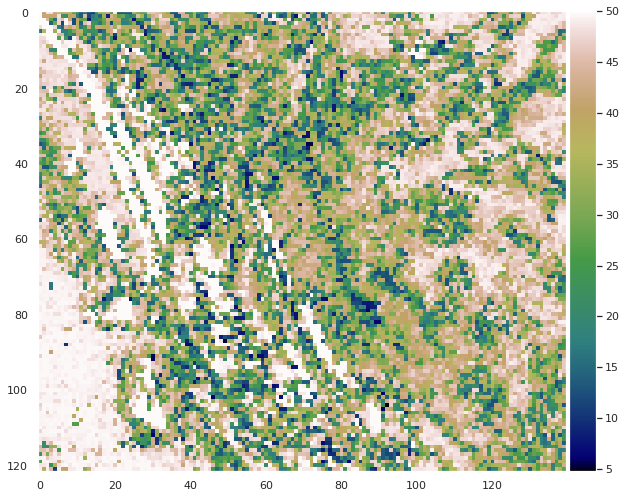

In [69]:
#Reshape Clusters to 2D dataframe
certainties = df_segm_pca_gmm['Certainty']
certainties_map = certainties.values.reshape(mixtureResidualOutput.shape[1],mixtureResidualOutput.shape[2])

# Let's see how our clusters map looks like
plt.rcParams["figure.figsize"] = [10, 10]

ax= plt.subplot()
ax.grid(False)
im = ax.imshow(certainties_map, cmap='gist_earth')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

plt.colorbar(im, cax=cax, ticks=np.linspace(0, 50, 11))
plt.show()

 Violin plots can help for a detailed analysis on the certainty distribution across clusters.

<AxesSubplot:xlabel='Cluster', ylabel='Certainty'>

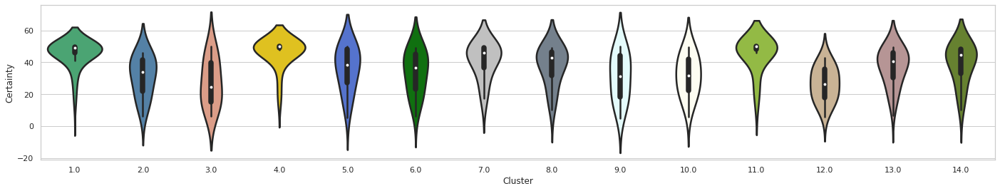

In [72]:
#Dataframe from cluster labels and certainties
cert = pd.DataFrame(np.vstack((clusters, certainties)).T, columns=['Cluster', 'Certainty'])

#Plot 1
import seaborn

a4_dims = (24, 4)
fig, ax = plt.subplots(figsize=a4_dims)

# creating a dictionary with one specific color per group:
#my_pal = {1: "steelblue", 2: "olivedrab", 3: "darksalmon", 4: "slategray", 5: "royalblue", 6: "rosybrown", 7: "silver", 8: "ivory", 9: "yellowgreen", 10: "green", 11: "gold", 12: "tan", 13: "mediumseagreen", 14: "lightcyan"}
my_pal = {1: "mediumseagreen", 2: "steelblue", 3: "darksalmon", 4: "gold", 5: "royalblue", 6: "green", 7: "silver", 8: "slategray", 9: "lightcyan", 10: "ivory", 11: "yellowgreen", 12: "tan", 13: "rosybrown", 14: "olivedrab"}

seaborn.set(style = 'whitegrid')
seaborn.violinplot(x ="Cluster",
             y ="Certainty",
             data = cert, palette=my_pal, bw=.8, linewidth = 2.5)

Violin plot is a type of kernel density estimate (KDE) visualization tool. The "negative" values you are seeing are just an artifact of KDEs. They are estimations of values in your data. It's not saying you have negative data, it's saying that your data contains values very close to negative values, namely 0.

To avoid violins whose lower tail go below zero, we have to tune the plot parameters.

<AxesSubplot:xlabel='Cluster', ylabel='Certainty'>

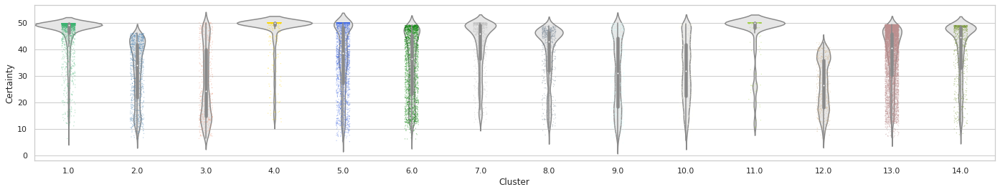

In [73]:
#For a more realistic 
a4_dims = (24, 4)
fig, ax = plt.subplots(figsize=a4_dims)

seaborn.set(style = 'whitegrid')
seaborn.violinplot(x ="Cluster",
             y ="Certainty",
             data = cert, color="0.9", bw=.15, linewidth = 1.5, width=1.1)

seaborn.stripplot(x ="Cluster",
             y ="Certainty",
             data = cert, palette=my_pal, size = 1.3, alpha=.4, zorder=1)

After identifying the flowering areas, we can visualize the spectral distribution of MRR across clusters by comparing the average residual reflectance (color line) against the population of flowering pixels (gray profiles).

First, let's pull out a close-up of the flowering cluster only.

Text(0.5, 0, 'Wavelengths(nm)')

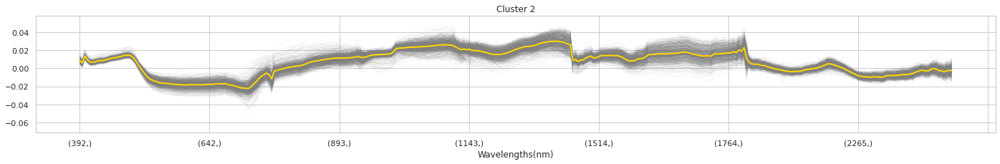

In [74]:
groups = df_segm_pca_gmm.drop(columns=['PC1','PC2','PC3','Segment','Certainty'])
groups.set_index("Segment_GMM_PCA", inplace = True)
groups = groups.apply(pd.to_numeric, errors='coerce')
groups = groups.groupby('Segment_GMM_PCA')

plt.rcParams["figure.figsize"] = [24, 3]
groups.get_group(1).T.plot(color='gray',linewidth=0.4,alpha=0.1, legend=False)
groups.get_group(1).T.mean(axis=1).plot(color='gold',linewidth=2).set_title("Cluster 2")
plt.xlabel('Wavelengths(nm)')

Now, let's visualize a comparative plot of MRR across all clusters.

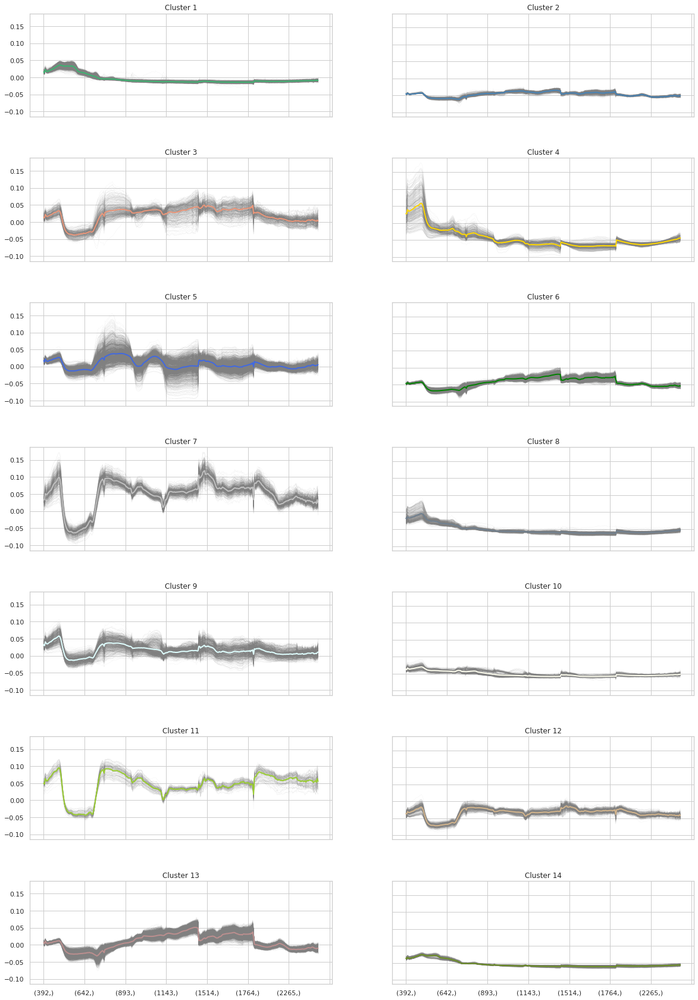

In [75]:
#Plotting Residual Reflectance per Cluster
rowlength = int(groups.ngroups/7)                         # fix up if odd number of groups
fig, axs = plt.subplots(figsize=(20,30), 
                        nrows=7, ncols=rowlength, sharex = 'col', sharey='col',   # fix as above
                        gridspec_kw=dict(hspace=0.4)) # Much control of gridspec

a=0
b=0

for i in range(0, groups.ngroups):
    if b>1:
        b=0
        a=a+1
    groups.get_group(i).T.plot(color='gray',linewidth=0.4,alpha=0.1, ax = axs[a, b], legend=False)
    groups.get_group(i).T.mean(axis=1).plot(color=my_pal[i+1],linewidth=2, ax = axs[a, b]).set_title('Cluster %d'%(i+1))
    b = b+1

Finally, if you want to bring back the "bad bands" to the MRR dataset for further analysis.

In [77]:
residual_out = xr.DataArray(mixtureResidualOutput, coords=aoi.coords, dims=aoi.dims, attrs=aoi.attrs)
residual_ds = residual_out.to_dataset (name="residual")
res_cube_clu = residual_ds.assign(cluster=(['x','y'],clusters_map.T))
res_cube_clu

<xarray.Dataset>
Dimensions:      (band: 425, x: 140, y: 122)
Coordinates:
    fwhm         (band) float64 5.57 5.58 5.58 5.58 5.59 ... 6.02 6.02 6.02 6.03
    wavelength   (band) float64 377.2 382.2 387.2 ... 2.496e+03 2.501e+03
  * band         (band) int64 1 2 3 4 5 6 7 8 ... 419 420 421 422 423 424 425
  * x            (x) float64 7.303e+05 7.303e+05 7.303e+05 ... 7.31e+05 7.31e+05
  * y            (y) float64 3.82e+06 3.82e+06 3.82e+06 ... 3.819e+06 3.819e+06
    spatial_ref  int64 0
Data variables:
    residual     (band, y, x) float64 0.1632 0.05017 ... -0.002237 -0.007775
    cluster      (x, y) int64 4 4 4 4 8 14 14 14 14 ... 6 13 13 13 6 6 6 13 13

Text(0.5, 0, 'Wavelengths(nm)')

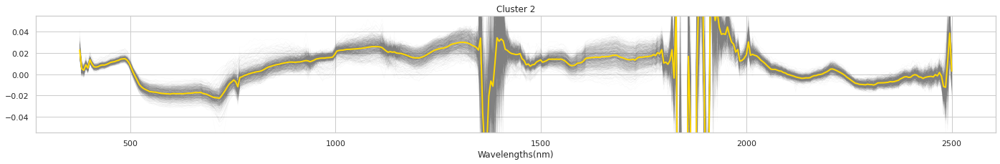

In [78]:
resi = pd.DataFrame((res_cube_clu.residual.values.reshape(425, -2).T), columns=waves.values.astype(int))
clu = res_cube_clu.cluster.T.values.reshape(-1).T
resi['cluster']=clu.tolist()
resi.set_index("cluster", inplace = True)
resi = resi.apply(pd.to_numeric, errors='coerce')
resi = resi.groupby('cluster')

from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

plt.rcParams["figure.figsize"] = [24, 3]
resi.get_group(2).T.plot(color='gray',linewidth=0.4,alpha=0.05, legend=False).xaxis.set_minor_locator(AutoMinorLocator(50))
resi.get_group(2).T.mean(axis=1).plot(color='gold',linewidth=2).set_title("Cluster 2")
plt.ylim([-0.055, 0.055])
plt.xlabel('Wavelengths(nm)')